Potential theses:

What creates controversy between critics and users?
    Are critics biased against a specific genre? (Is there any genre where critic scores are consistently lower?)

Have reviews changed over time?

Genre composition changed over time?

PRESENCE/PERCENTAGE of genre has or not relationship with avg scores for genre?

THESIS: There was a genre shift in the 80s & 90s, and it changed the way people review and rate music


Do you really like the music you like?
    -Stacked line chart of genres over time (maybe aggregate in 5-year increments)
    -Chart showing critical review score turnaround in last few years
    -Quartile analysis of user reviews, to see if all reviews are going down or if more people are just bombing it



In [226]:
import pandas as pd
import numpy as np
import math

from scipy import stats
from sklearn import preprocessing
from statsmodels.graphics.regressionplots import *

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import seaborn as sns

from scipy.stats import ttest_ind

sns.set_context('notebook')

In [2]:
total_set = pd.read_csv('../data/raw/album_ratings.csv')
total_set.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32358 entries, 0 to 32357
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Artist                   32358 non-null  object 
 1   Title                    32357 non-null  object 
 2   Release Month            31769 non-null  object 
 3   Release Day              31768 non-null  object 
 4   Release Year             32358 non-null  int64  
 5   Format                   32358 non-null  object 
 6   Label                    28902 non-null  object 
 7   Genre                    24398 non-null  object 
 8   Metacritic Critic Score  13884 non-null  float64
 9   Metacritic Reviews       13884 non-null  float64
 10  Metacritic User Score    9099 non-null   float64
 11  Metacritic User Reviews  10574 non-null  float64
 12  AOTY Critic Score        32358 non-null  int64  
 13  AOTY Critic Reviews      32358 non-null  int64  
 14  AOTY User Score       

In [3]:
total_set.describe()

,Release Year,Metacritic Critic Score,Metacritic Reviews,Metacritic User Score,Metacritic User Reviews,AOTY Critic Score,AOTY Critic Reviews,AOTY User Score,AOTY User Reviews
count,32358.000000,13884.000000,13884.000000,9099.000000,10574.000000,32358.000000,32358.000000,32358.000000,32358.000000
mean,2006.667810,73.285148,12.483434,7.782020,63.163893,72.808332,5.645003,71.283794,61.988782
std,14.132255,8.399107,7.911986,0.978036,325.204608,11.214989,6.179734,9.653036,184.221848
min,1940.000000,15.000000,4.000000,1.400000,3.000000,4.000000,1.000000,0.000000,1.000000
25%,2002.000000,69.000000,6.000000,7.400000,8.000000,67.000000,2.000000,67.000000,7.000000
50%,2012.000000,74.000000,10.000000,8.000000,14.000000,74.000000,3.000000,73.000000,14.000000
75%,2017.000000,79.000000,17.000000,8.500000,37.000000,80.000000,7.000000,78.000000,39.000000
max,2020.000000,98.000000,51.000000,9.500000,14720.000000,100.000000,48.000000,100.000000,4530.000000


In [39]:
decade = total_set['Release Year']
decade = decade/10
decade = decade.astype(int)
decade = (decade * 10)

total_set['Release Decade'] = decade


In [4]:
score_cols = []
for col in total_set.columns :
    if "Score" in col :
        score_cols.append(col)

array([[<Axes: title={'center': 'Metacritic Critic Score'}>,
        <Axes: title={'center': 'Metacritic User Score'}>],
       [<Axes: title={'center': 'AOTY Critic Score'}>,
        <Axes: title={'center': 'AOTY User Score'}>]], dtype=object)

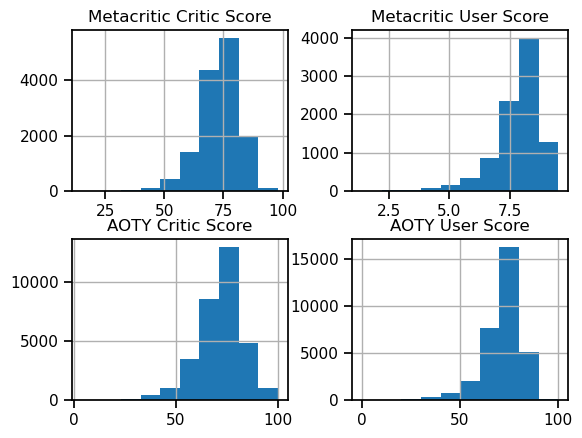

In [5]:
total_set[score_cols].hist()

<Axes: xlabel='AOTY Critic Score', ylabel='AOTY User Score'>

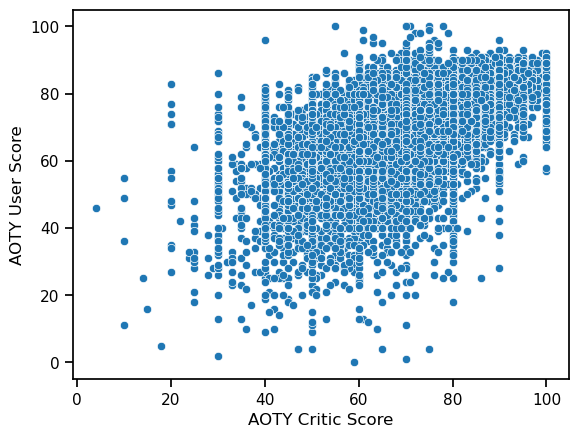

In [6]:
sns.scatterplot(data=total_set, x='AOTY Critic Score', y='AOTY User Score')

In [7]:
# Only this one was on a 10-point scale, but fortunately it goes to one decimal point,
# so just multiplying by 10 should be enough to make all score columns comparable.

total_set['Metacritic User Score'] = total_set['Metacritic User Score'] * 10

<Axes: >

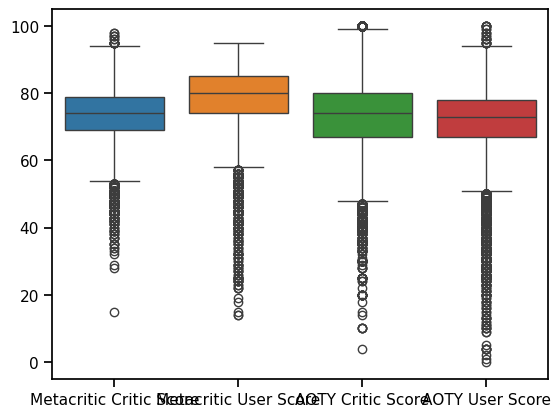

In [8]:
sns.boxplot(total_set[score_cols])

<Axes: >

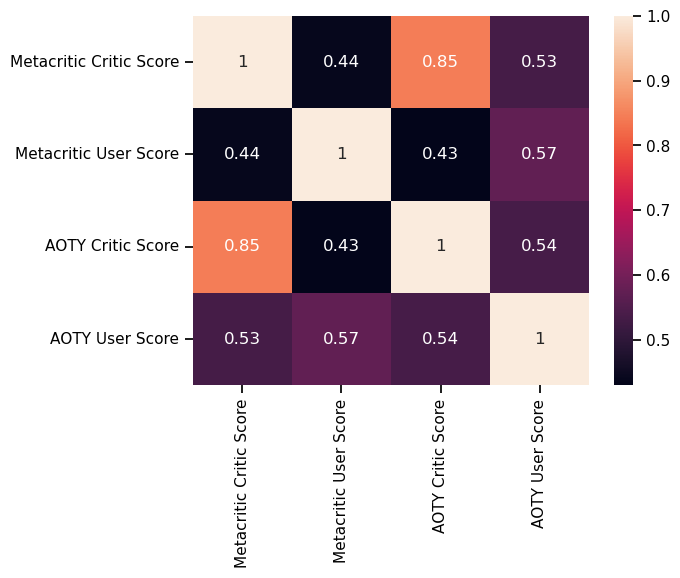

In [9]:
corrs = total_set[score_cols].corr()

sns.heatmap(corrs, annot=True)

We see that scores are positively correlated across the board, but critic scores correlate better with each other than with user scores.

This does suggest that they may have different biases. Hooray for exploration!

Since there are a lot of nulls in the Metacritic columns, let's simplify our exploration and focus only on AOTY for now.

In [10]:
scores = [col for col in score_cols if 'AOTY' in col]
critics = 'AOTY Critic Score'
users = 'AOTY User Score'


In [11]:
total_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32358 entries, 0 to 32357
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Artist                   32358 non-null  object 
 1   Title                    32357 non-null  object 
 2   Release Month            31769 non-null  object 
 3   Release Day              31768 non-null  object 
 4   Release Year             32358 non-null  int64  
 5   Format                   32358 non-null  object 
 6   Label                    28902 non-null  object 
 7   Genre                    24398 non-null  object 
 8   Metacritic Critic Score  13884 non-null  float64
 9   Metacritic Reviews       13884 non-null  float64
 10  Metacritic User Score    9099 non-null   float64
 11  Metacritic User Reviews  10574 non-null  float64
 12  AOTY Critic Score        32358 non-null  int64  
 13  AOTY Critic Reviews      32358 non-null  int64  
 14  AOTY User Score       

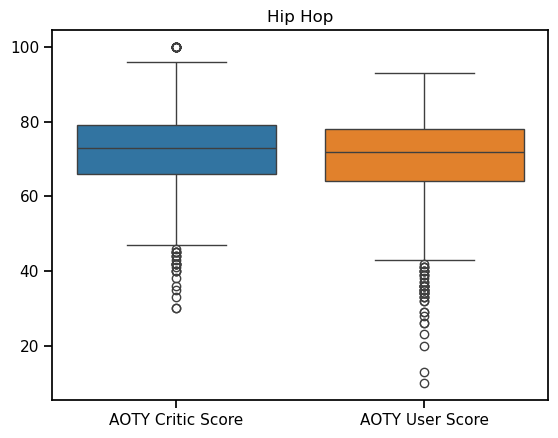

Mean critic score: 72.03267211201867
Mean user score: 69.5565927654609
P-value: 2.1380713414422747e-11


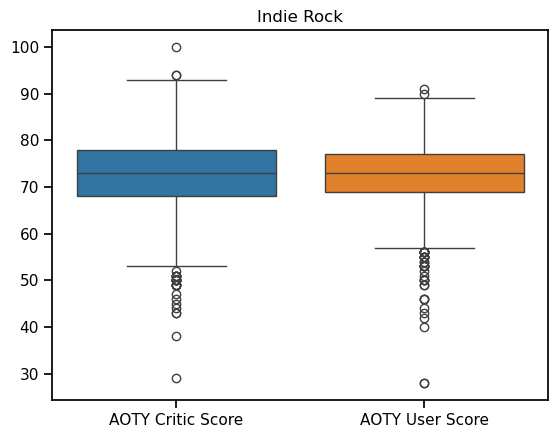

Mean critic score: 72.41814837522992
Mean user score: 72.76824034334764
P-value: 0.18066054477798313


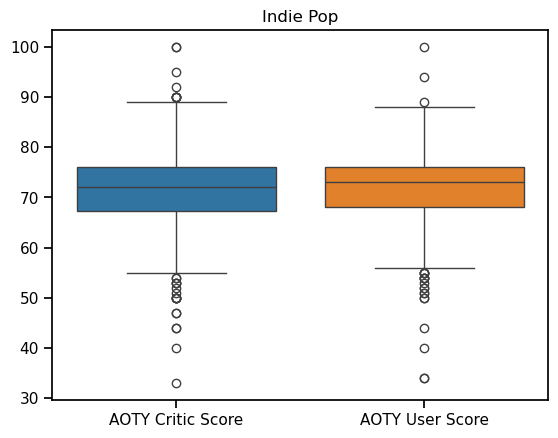

Mean critic score: 71.38649706457926
Mean user score: 72.0078277886497
P-value: 0.04173361311883884


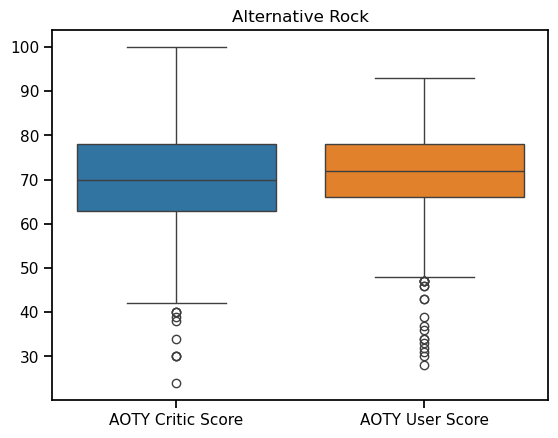

Mean critic score: 70.06706114398422
Mean user score: 71.1094674556213
P-value: 0.0232185899999691


In [18]:
v_freq_genre_df = total_set[total_set['Genre'].isin(v_frequent_genre_cols)]


for genre in v_frequent_genre_cols :
    current_df = total_set[total_set['Genre']==genre]
    sns.boxplot(current_df[scores])
    plt.title(genre)
    plt.show()

    critic_scores = current_df[critics].values
    critic_mean = critic_scores.mean()
    
    user_scores = current_df[users].values
    user_mean = user_scores.mean()

    t_stat, p_value = ttest_ind(critic_scores, user_scores, equal_var=False)
    print(f'Mean critic score: {critic_mean}')
    print(f'Mean user score: {user_mean}')
    print(f'P-value: {p_value}')

All of these P-values indicate that there is measurable difference between critic and user score means, and that this difference varies across genre.

For example, users are generally harder on Hip Hop than critics, while they're more forgiving of Alt Rock than critics.

In [19]:
genre_counts = total_set['Genre'].value_counts()

v_frequent_genres = genre_counts[genre_counts > 1000]
v_frequent_genre_cols = list(v_frequent_genres.index)
v_frequent_genre_cols

['Hip Hop', 'Indie Rock', 'Indie Pop', 'Alternative Rock']

Change over time?
---

Let's see if AOTY critic scores have changed over time.

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\2100784146.py:7: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = total_set.groupby('Release Year').mean()


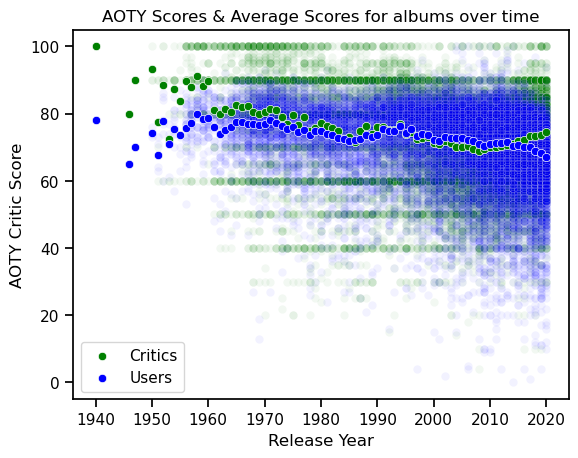

In [22]:
sns.scatterplot(data=total_set, x='Release Year', y=critics, color="Green", alpha=0.05)
sns.scatterplot(data=total_set, x='Release Year', y=users, color="Blue", alpha=0.05)

plt.title('AOTY Scores & Average Scores for albums over time')


mean_df = total_set.groupby('Release Year').mean()

sns.scatterplot(data=mean_df, x='Release Year', y=critics, color='Green', label='Critics')

sns.scatterplot(data=mean_df, x='Release Year', y=users, color='Blue', label='Users')

plt.legend()
plt.show()

In [153]:
total_set.columns

Index(['Artist', 'Title', 'Release Month', 'Release Day', 'Release Year',
       'Format', 'Label', 'Genre', 'Metacritic Critic Score',
       'Metacritic Reviews', 'Metacritic User Score',
       'Metacritic User Reviews', 'AOTY Critic Score', 'AOTY Critic Reviews',
       'AOTY User Score', 'AOTY User Reviews', 'Release Decade', 'Count'],
      dtype='object')

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\681286530.py:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = total_set.groupby('Release Year').mean()


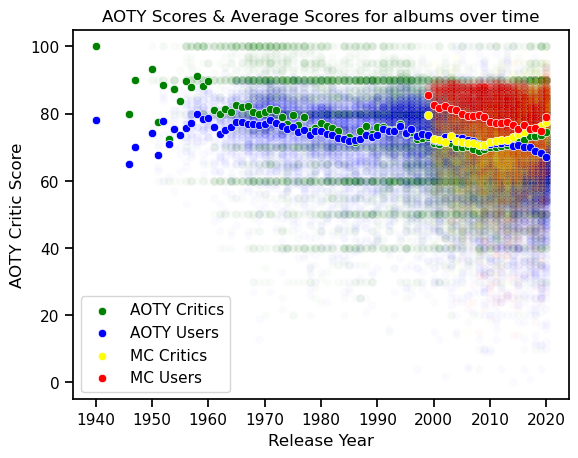

In [185]:
sns.scatterplot(data=total_set, x='Release Year', y=critics, color="Green", alpha=0.02)
sns.scatterplot(data=total_set, x='Release Year', y=users, color="Blue", alpha=0.02)

sns.scatterplot(data=total_set, x='Release Year', y='Metacritic Critic Score', color="Yellow", alpha=0.02)
sns.scatterplot(data=total_set, x='Release Year', y='Metacritic User Score', color="Red", alpha=0.02)

plt.title('AOTY Scores & Average Scores for albums over time')


mean_df = total_set.groupby('Release Year').mean()

sns.scatterplot(data=mean_df, x='Release Year', y=critics, color='Green', label='AOTY Critics')
sns.scatterplot(data=mean_df, x='Release Year', y=users, color='Blue', label='AOTY Users')
sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic Critic Score', color='Yellow', label='MC Critics')
sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic User Score', color='Red', label='MC Users')



plt.legend()
plt.show()

It looks like critic scores are trending upward, while user scores may be trending downward! Let's see if that holds in our top genres. If so, we can play with that subset of the df instead of the whole thing.

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\4105583246.py:14: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = v_freq_genre_df.groupby('Release Year').mean()


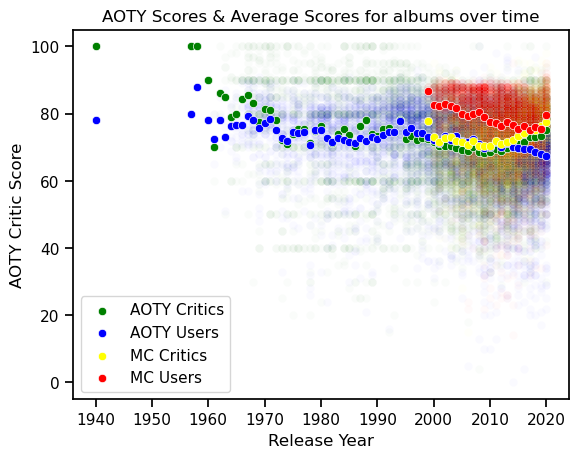

In [237]:
v_frequent_genres = genre_counts[genre_counts > 300]
v_frequent_genre_cols = list(v_frequent_genres.index)
v_frequent_genre_df = total_set[total_set['Genre'].isin(v_frequent_genre_cols)]

sns.scatterplot(data=v_freq_genre_df, x='Release Year', y=critics, color="Green", alpha=0.02)
sns.scatterplot(data=v_freq_genre_df, x='Release Year', y=users, color="Blue", alpha=0.02)

sns.scatterplot(data=v_freq_genre_df, x='Release Year', y='Metacritic Critic Score', color="Yellow", alpha=0.02)
sns.scatterplot(data=v_freq_genre_df, x='Release Year', y='Metacritic User Score', color="Red", alpha=0.02)

plt.title('AOTY Scores & Average Scores for albums over time')


mean_df = v_freq_genre_df.groupby('Release Year').mean()

sns.scatterplot(data=mean_df, x='Release Year', y=critics, color='Green', label='AOTY Critics')
sns.scatterplot(data=mean_df, x='Release Year', y=users, color='Blue', label='AOTY Users')
sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic Critic Score', color='Yellow', label='MC Critics')
sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic User Score', color='Red', label='MC Users')



plt.legend()
plt.show()

Seems to be.

In [190]:
v_freq_genre_df['Genre']

4        Singer-Songwriter
6                     Folk
7                      Pop
8         Alternative Rock
9               Indie Rock
               ...        
32262    Singer-Songwriter
32303                 Folk
32319    Singer-Songwriter
32332           Indie Rock
32341    Singer-Songwriter
Name: Genre, Length: 11464, dtype: object

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


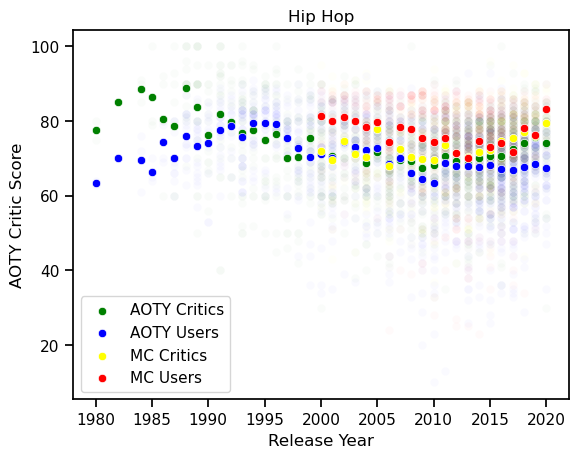

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


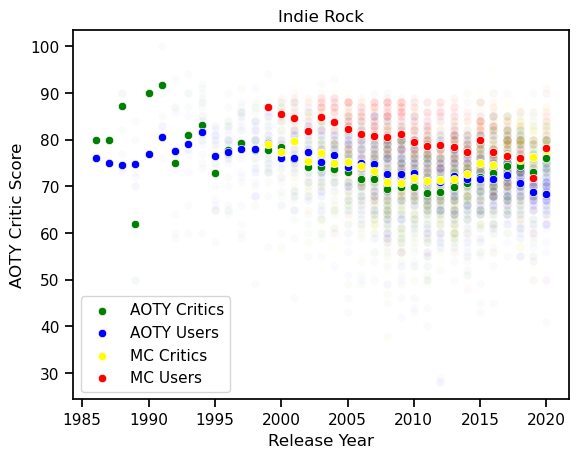

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


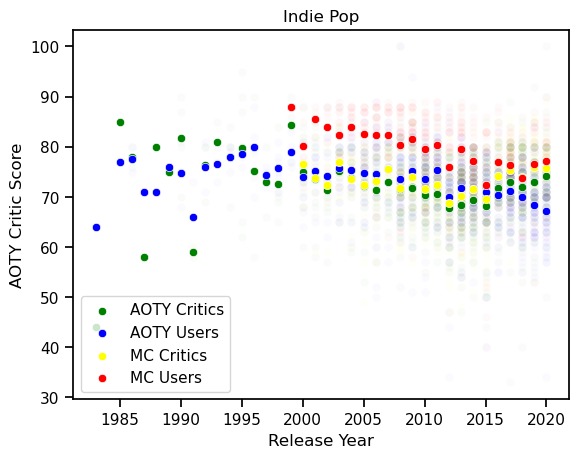

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


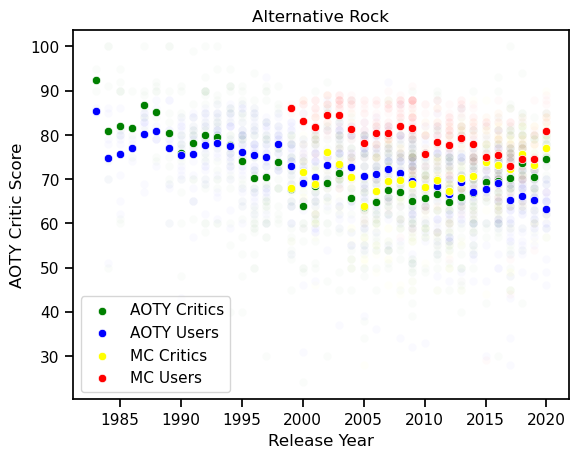

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


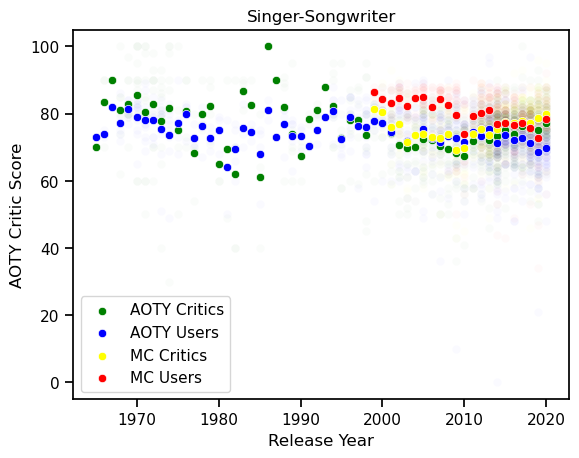

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


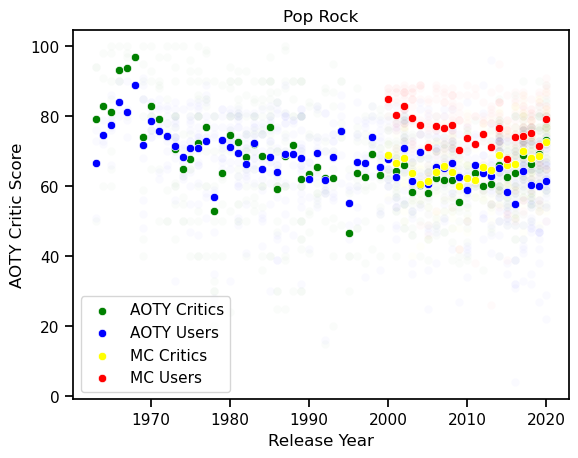

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


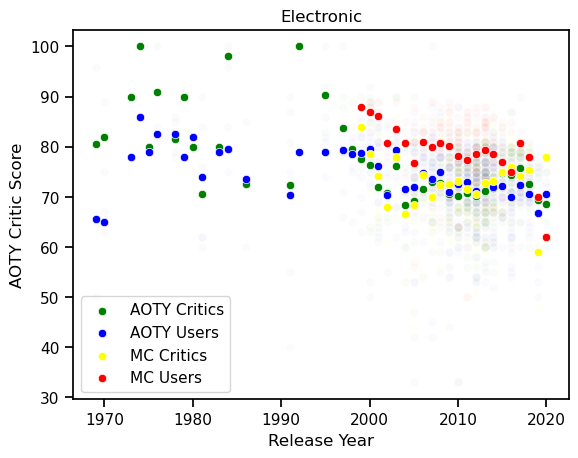

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


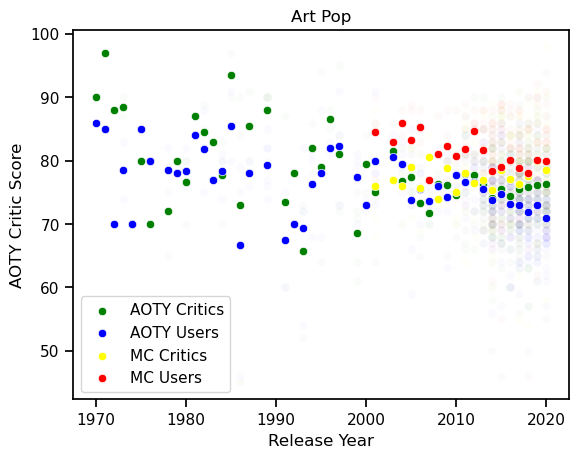

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


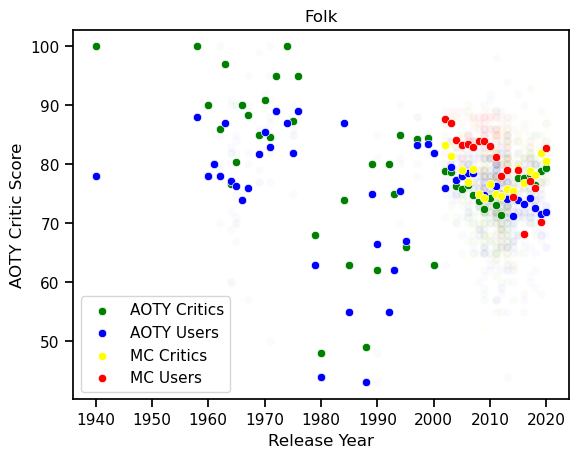

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


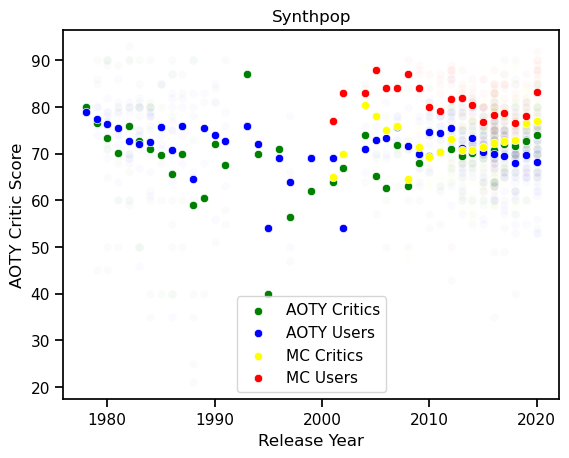

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


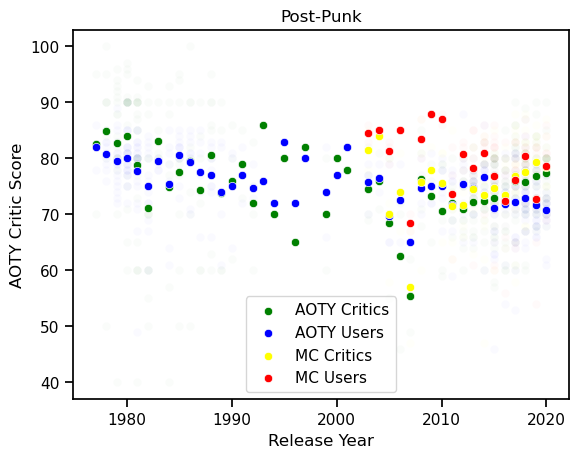

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


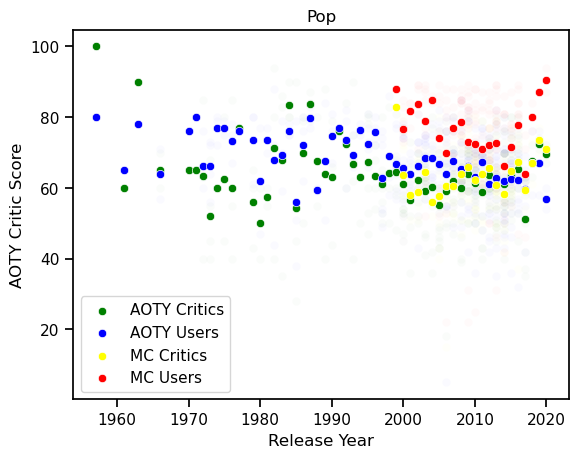

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


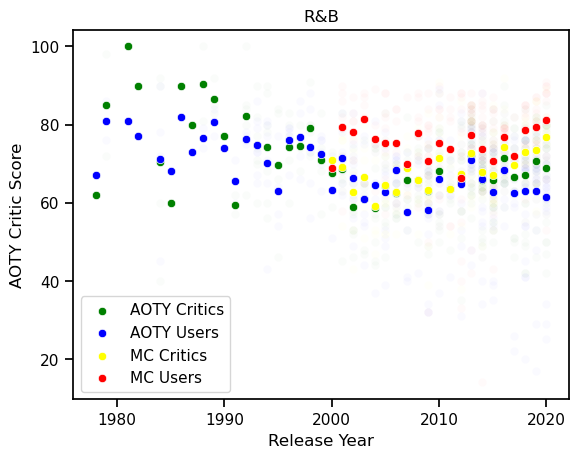

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


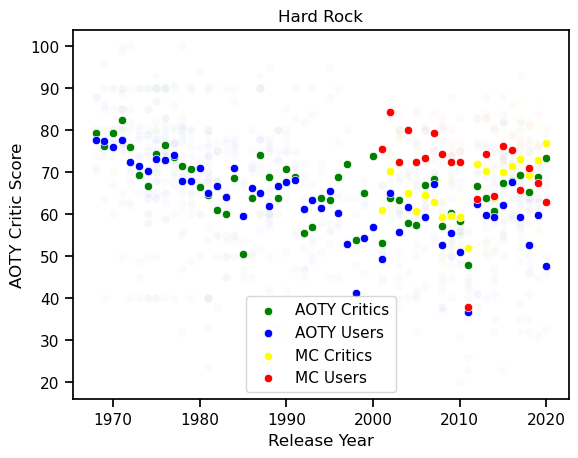

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


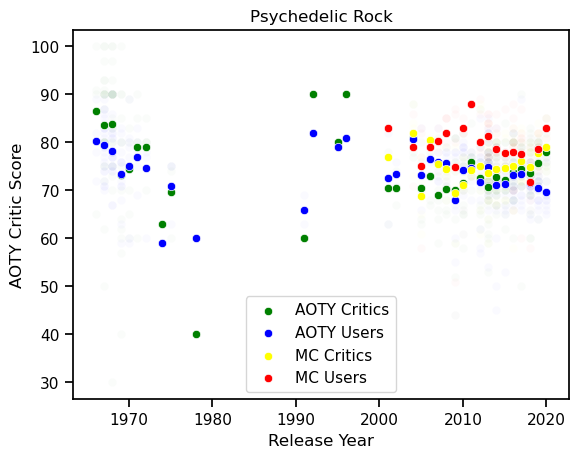

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


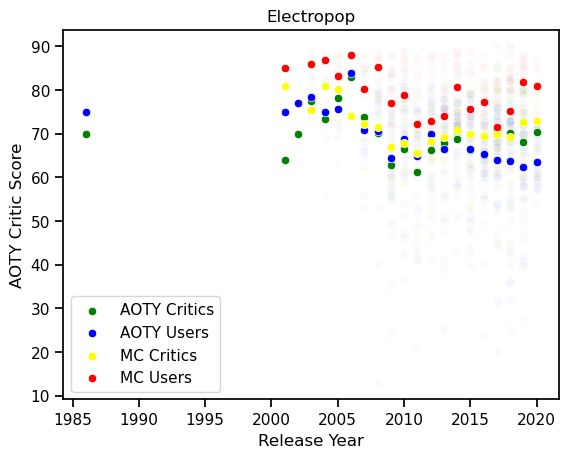

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\312541727.py:12: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_df = current_df.groupby('Release Year').mean()


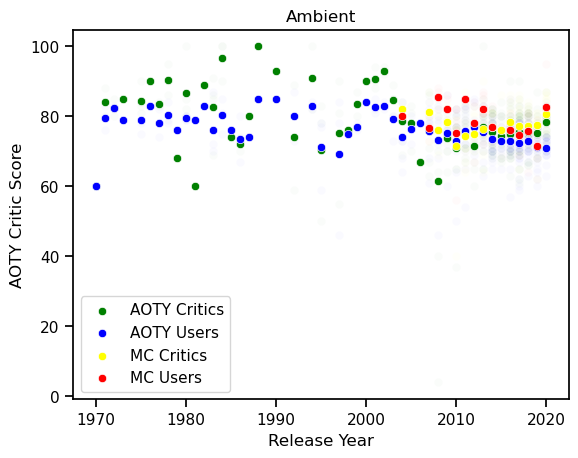

In [192]:
for genre in v_frequent_genre_cols :
    current_df = v_freq_genre_df[v_freq_genre_df['Genre']==genre]
    sns.scatterplot(data=current_df, x='Release Year', y=critics, color="Green", alpha=0.02)
    sns.scatterplot(data=current_df, x='Release Year', y=users, color="Blue", alpha=0.02)

    sns.scatterplot(data=current_df, x='Release Year', y='Metacritic Critic Score', color="Yellow", alpha=0.02)
    sns.scatterplot(data=current_df, x='Release Year', y='Metacritic User Score', color="Red", alpha=0.02)

    plt.title('AOTY Scores & Average Scores for albums over time')


    mean_df = current_df.groupby('Release Year').mean()

    sns.scatterplot(data=mean_df, x='Release Year', y=critics, color='Green', label='AOTY Critics')
    sns.scatterplot(data=mean_df, x='Release Year', y=users, color='Blue', label='AOTY Users')
    sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic Critic Score', color='Yellow', label='MC Critics')
    sns.scatterplot(data=mean_df, x='Release Year', y='Metacritic User Score', color='Red', label='MC Users')
    
    plt.legend()
    plt.title(genre)
    plt.show()

The correlation holds for some but not all of the individual genres.

I wonder if lowering reviews cause less of that genre of music to be created?

I'll create a new variable that stores the shift in mean critic & user reviews (AOTY only, since Metacritic can be sparse) since the previous year, and see if there's a correlation between that and the number of albums in that genre in the following year.

In [215]:
# Create a df with years as rows, genres as cols, mean AOTY crit score as values

critic_score_df = pd.DataFrame()

for year in range(v_freq_genre_df['Release Year'].min(), 2021) :
    current_df = v_freq_genre_df[v_freq_genre_df['Release Year']==year]
    current_df = current_df.groupby('Genre').mean(numeric_only=True)

    for genre in v_frequent_genre_cols :
        if genre in current_df.index :
            critic_score_df.loc[year, genre] = current_df.loc[genre, 'AOTY Critic Score']

critic_score_df

,Folk,Pop,Pop Rock,Singer-Songwriter,Psychedelic Rock,Hard Rock,Electronic,Art Pop,Ambient,Post-Punk,Synthpop,R&B,Hip Hop,Indie Pop,Alternative Rock,Indie Rock,Electropop
1940,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1957,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1958,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960,90.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1961,80.000000,60.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016,77.647059,65.428571,63.900000,73.911765,73.916667,68.000000,74.361111,74.473684,74.964286,72.300000,70.808511,71.375000,70.676923,71.833333,69.529412,72.936170,65.080000
2017,78.300000,51.250000,69.047619,76.377358,74.388889,69.416667,75.769231,75.476190,75.641026,76.000000,72.096774,66.571429,72.612613,72.913580,70.212766,74.421053,70.805556
2018,76.562500,67.500000,66.361111,75.350000,73.681818,65.363636,72.611111,75.901961,75.592593,75.875000,71.571429,67.142857,74.123711,71.975904,73.552632,74.440000,70.176471
2019,78.928571,72.500000,69.411765,75.234375,75.647059,69.000000,69.285714,76.162791,75.190476,76.851852,72.656250,70.750000,75.643836,73.046875,70.551724,73.014706,68.030303


In [248]:
v_freq_genre_df.columns

Index([                                         'Artist',
                                                 'Title',
                                         'Release Month',
                                           'Release Day',
                                          'Release Year',
                                                'Format',
                                                 'Label',
                                                 'Genre',
                               'Metacritic Critic Score',
                                    'Metacritic Reviews',
       ...
       (32192, 'YoY Genre AOTY Critic Score Difference'),
       (32200, 'YoY Genre AOTY Critic Score Difference'),
       (32222, 'YoY Genre AOTY Critic Score Difference'),
       (32240, 'YoY Genre AOTY Critic Score Difference'),
       (32249, 'YoY Genre AOTY Critic Score Difference'),
       (32262, 'YoY Genre AOTY Critic Score Difference'),
       (32303, 'YoY Genre AOTY Critic Score Difference'),
   

In [254]:
genre_counts = total_set['Genre'].value_counts()
v_frequent_genres = genre_counts[genre_counts > 300]
v_frequent_genre_cols = list(v_frequent_genres.index)
v_freq_genre_df = total_set[total_set['Genre'].isin(v_frequent_genre_cols)]
v_freq_genre_df['Count'] = 1
v_freq_genre_df['YoY Genre AOTY Critic Score Difference'] = np.nan


def add_YoY_critic_difference(row) :
    # print(row)
    year = row['Release Year']
    genre = row['Genre']

    indexes = list(critic_score_df.index)

    if year in indexes and year - 1 in indexes :

        value = critic_score_df.loc[year, genre]
        previous_value = critic_score_df.loc[year-1, genre]

        if not math.isnan(value) and not math.isnan(previous_value) :

            return value - previous_value
        
        else :
            return np.nan
        
    else :
        return np.nan


v_freq_genre_df['YoY Genre AOTY Critic Score Difference'] = \
    v_freq_genre_df.apply(add_YoY_critic_difference, axis=1)




# for index, row in v_freq_genre_df.iterrows() :
#     year = row['Release Year']
#     genre = row['Genre']

#     if year in indexes and year - 1 in indexes :
#         value = critic_score_df.loc[year, genre]
#         previous_value = critic_score_df.loc[year-1, genre]
        
#         if ~math.isnan(value) and ~math.isnan(previous_value) :
#             v_freq_genre_df.loc[index, 'YoY Genre AOTY Critic Score Difference'] = \
#             value = previous_value


C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3626676849.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v_freq_genre_df['Count'] = 1
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3626676849.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v_freq_genre_df['YoY Genre AOTY Critic Score Difference'] = np.nan


Artist                                          Andrew Bird
Title                                           Noble Beast
Release Month                                       January
Release Day                                              20
Release Year                                           2009
Format                                                   LP
Label                                            Fat Possum
Genre                                     Singer-Songwriter
Metacritic Critic Score                                79.0
Metacritic Reviews                                     29.0
Metacritic User Score                                  87.0
Metacritic User Reviews                                47.0
AOTY Critic Score                                        74
AOTY Critic Reviews                                      24
AOTY User Score                                          78
AOTY User Reviews                                        44
Release Decade                          

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3626676849.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v_freq_genre_df['YoY Genre AOTY Critic Score Difference'] = \


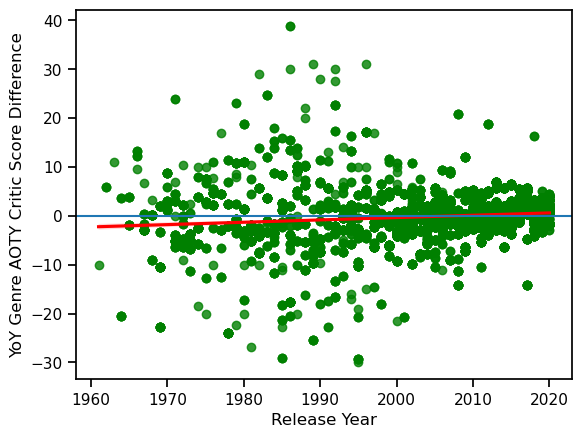

In [270]:
sns.regplot(data=v_freq_genre_df, x='Release Year', y='YoY Genre AOTY Critic Score Difference', color='Green', line_kws={'color':'Red'})

plt.axhline(y=0)

In [284]:
# Create a df with years as rows, genres as cols, mean AOTY crit score as values

count_df = pd.DataFrame()

for year in range(v_freq_genre_df['Release Year'].min(), 2021) :
    current_df = v_freq_genre_df[v_freq_genre_df['Release Year']==year]
    current_df = current_df.groupby('Genre').count()

    for genre in v_frequent_genre_cols :
        if genre in current_df.index :
            count_df.loc[year, genre] = current_df.loc[genre, 'AOTY Critic Score']

count_df

,Folk,Pop,Pop Rock,Singer-Songwriter,Psychedelic Rock,Hard Rock,Electronic,Art Pop,Ambient,Post-Punk,Synthpop,R&B,Hip Hop,Indie Pop,Alternative Rock,Indie Rock,Electropop
1940,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1957,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1958,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1960,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1961,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016,17.0,14.0,30.0,68.0,24.0,8.0,36.0,38.0,28.0,20.0,47.0,16.0,130.0,54.0,51.0,94.0,25.0
2017,20.0,8.0,42.0,53.0,18.0,12.0,26.0,63.0,39.0,25.0,31.0,14.0,111.0,81.0,47.0,114.0,36.0
2018,16.0,2.0,36.0,60.0,22.0,11.0,18.0,51.0,27.0,32.0,35.0,28.0,97.0,83.0,38.0,100.0,34.0
2019,14.0,2.0,34.0,64.0,17.0,9.0,7.0,43.0,21.0,27.0,32.0,24.0,73.0,64.0,29.0,68.0,33.0


In [285]:
def add_YoY_genre_difference(row) :
    # print(row)
    # print("---")
    year = row['Release Year']
    genre = row['Genre']
    # print(year)
    # print(genre)
    indexes = list(count_df.index)
    # print(indexes)

    if year in indexes and year - 1 in indexes :

        value = count_df.loc[year, genre]
        previous_value = count_df.loc[year-1, genre]
        # print(f'Value = {value}')
        # print(f'Prev val = {previous_value}')

        if not math.isnan(value) and not math.isnan(previous_value) :
            # print(value - previous_value)
            # print('Returning value')
            return value - previous_value
        
        else :
            # print('returning from inner loop')
            return np.nan
        
    else :
        # print('Returning from outer loop')
        return np.nan


v_freq_genre_df['YoY Genre Count Difference'] = \
    v_freq_genre_df.apply(add_YoY_genre_difference, axis=1)


10.0
19.0
-1.0
21.0
1.0
-3.0
19.0
1.0
19.0
-1.0
-3.0
21.0
21.0
-3.0
10.0
-3.0
19.0
21.0
-3.0
-3.0
10.0
5.0
1.0
5.0
1.0
-3.0
19.0
19.0
1.0
21.0
0.0
13.0
-12.0
1.0
13.0
1.0
1.0
10.0
1.0
10.0
6.0
19.0
13.0
21.0
10.0
-3.0
1.0
13.0
-1.0
21.0
1.0
1.0
2.0
1.0
19.0
5.0
21.0
-3.0
21.0
13.0
5.0
1.0
-3.0
2.0
21.0
-3.0
0.0
10.0
10.0
19.0
1.0
21.0
-3.0
21.0
1.0
21.0
10.0
1.0
1.0
-3.0
19.0
4.0
19.0
1.0
1.0
21.0
1.0
13.0
21.0
6.0
-3.0
13.0
6.0
6.0
21.0
19.0
1.0
10.0
15.0
1.0
21.0
10.0
1.0
-3.0
-3.0
19.0
13.0
19.0
4.0
21.0
19.0
0.0
13.0
1.0
10.0
1.0
21.0
1.0
13.0
21.0
21.0
10.0
10.0
-3.0
4.0
10.0
-3.0
5.0
1.0
13.0
-1.0
1.0
21.0
-3.0
-7.0
17.0
7.0
7.0
-7.0
0.0
8.0
13.0
17.0
16.0
8.0
-7.0
6.0
4.0
6.0
-5.0
9.0
-7.0
16.0
-8.0
-6.0
0.0
7.0
2.0
7.0
16.0
2.0
-4.0
-3.0
-6.0
-2.0
2.0
-2.0
4.0
7.0
13.0
2.0
1.0
-11.0
-2.0
-2.0
1.0
-2.0
0.0
-2.0
6.0
3.0
1.0
13.0
13.0
8.0
6.0
-7.0
13.0
6.0
1.0
6.0
6.0
13.0
13.0
8.0
-5.0
13.0
-5.0
2.0
-26.0
2.0
4.0
19.0
19.0
-5.0
1.0
-11.0
7.0
-3.0
-7.0
7.0
7.0
-7.0
1.0
4.0
17.0
1.

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3282933195.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v_freq_genre_df['YoY Genre Count Difference'] = \


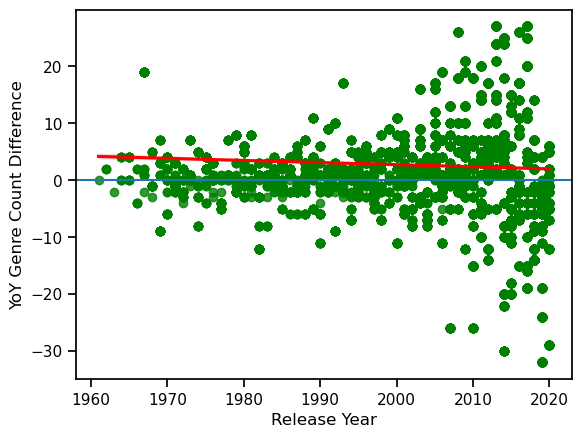

In [286]:
sns.regplot(data=v_freq_genre_df, x='Release Year', y='YoY Genre Count Difference', color='Green', line_kws={'color':'Red'})

plt.axhline(y=0)

In [305]:
maximum = len(v_freq_genre_df)

v_freq_genre_df['Adjusted Album Count'] = np.nan

for i in range(1, maximum) :
    v_freq_genre_df.iloc[i, 20] = v_freq_genre_df.iloc[i-3, 19] 


C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3543021756.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  v_freq_genre_df['Adjusted Album Count'] = np.nan


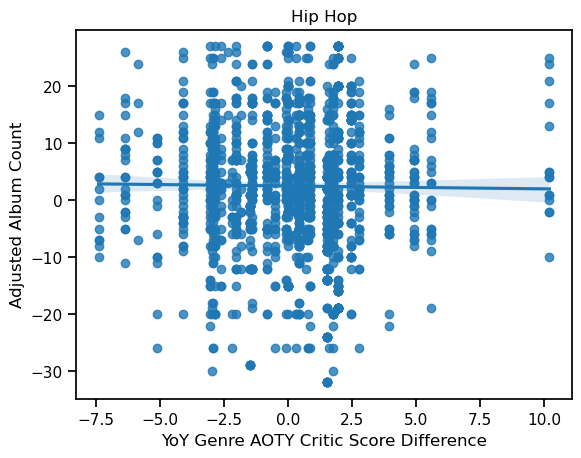

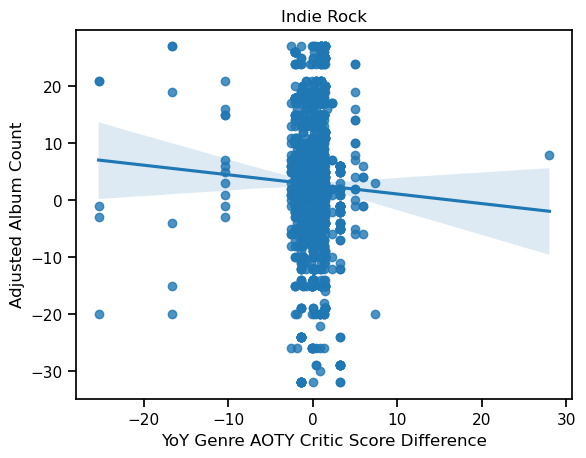

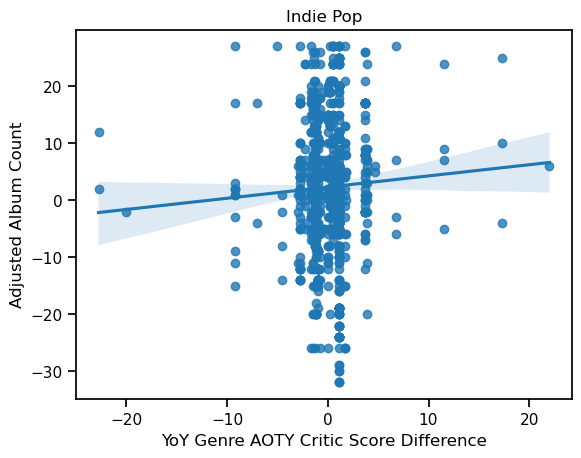

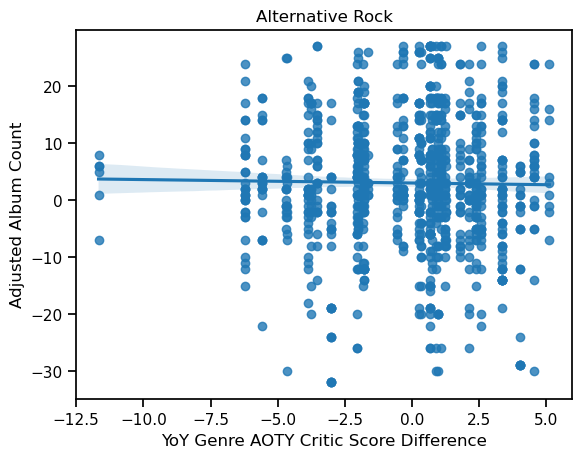

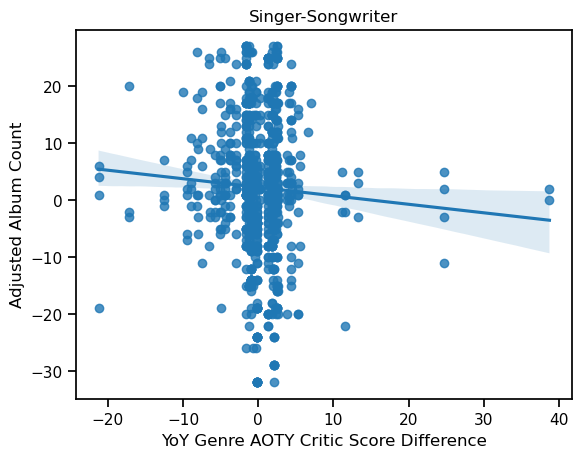

...

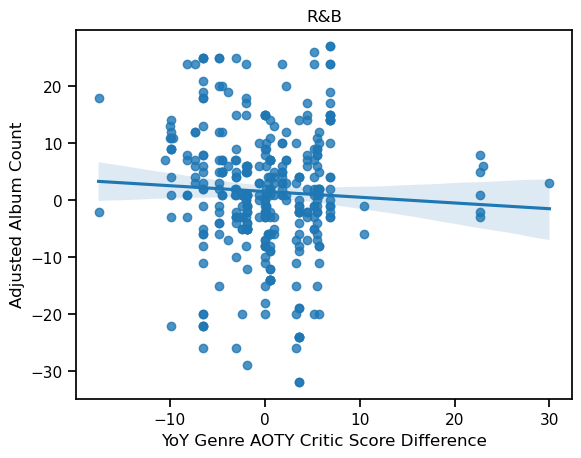

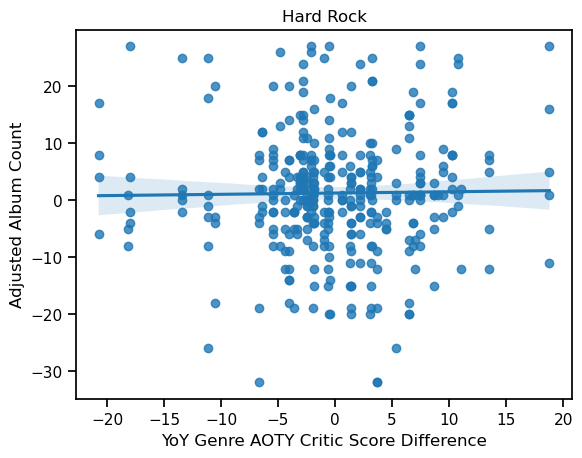

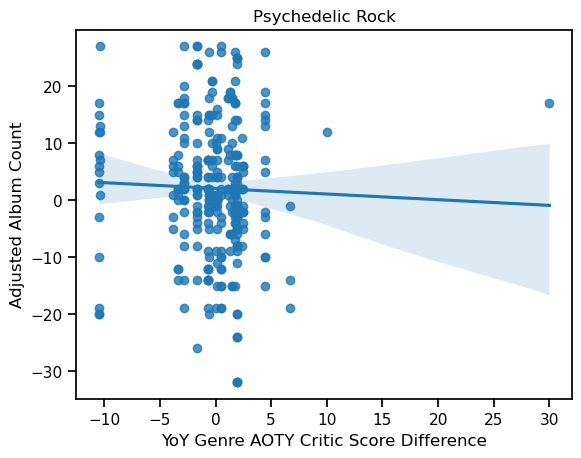

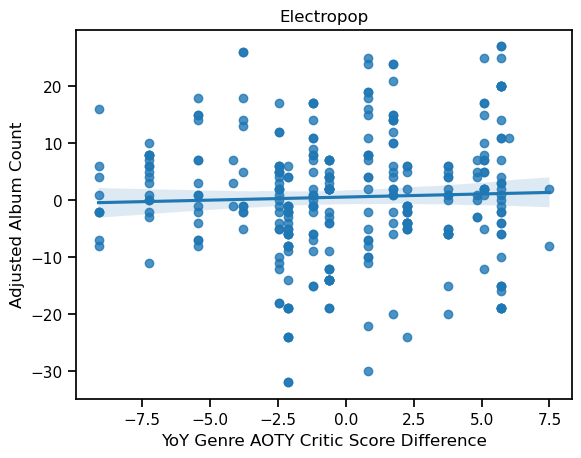

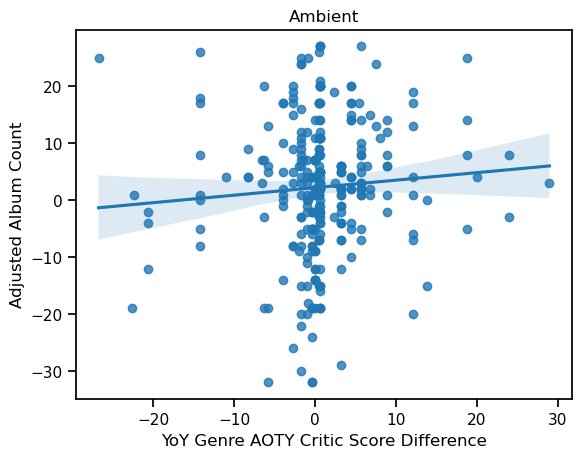

In [306]:
for genre in v_frequent_genre_cols :
    current_df = v_freq_genre_df[v_freq_genre_df['Genre']==genre]
    sns.regplot(data=current_df, x='YoY Genre AOTY Critic Score Difference', y='Adjusted Album Count')
    plt.title(genre)
    plt.show()

Interestingly, poor critical reviews across a genre does not seem to lead to decreasing numbers of albums in that genre being published in the following 1-3 years.

<Axes: >

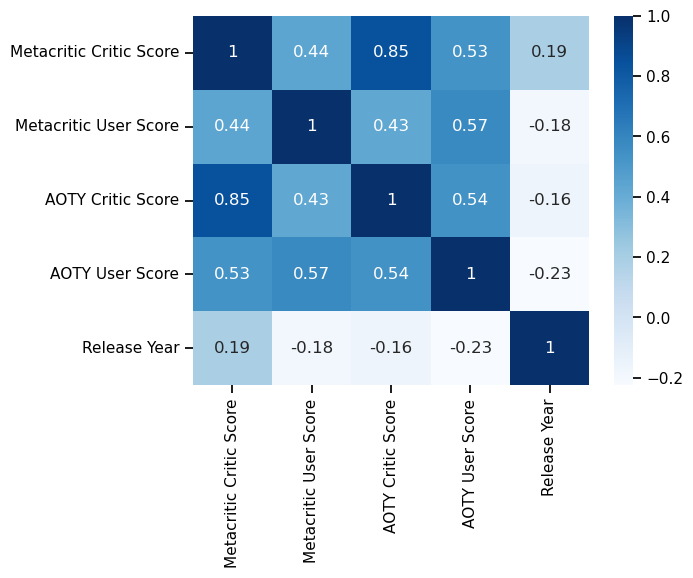

In [24]:
considered_cols = score_cols.copy()
considered_cols.append('Release Year')

year_corrs = total_set[considered_cols].corr()
sns.heatmap(year_corrs, cmap='Blues', annot=True)

It does seem that there's a slight but slight inverse correlation.

Let's see if genre affects this. To get any meaningful insight, we'll have to only look at the common genres.

In [186]:
v_frequent_genres = genre_counts[genre_counts > 300]
v_frequent_genre_cols = list(v_frequent_genres.index)
v_frequent_genre_df = total_set[total_set['Genre'].isin(v_frequent_genre_cols)]

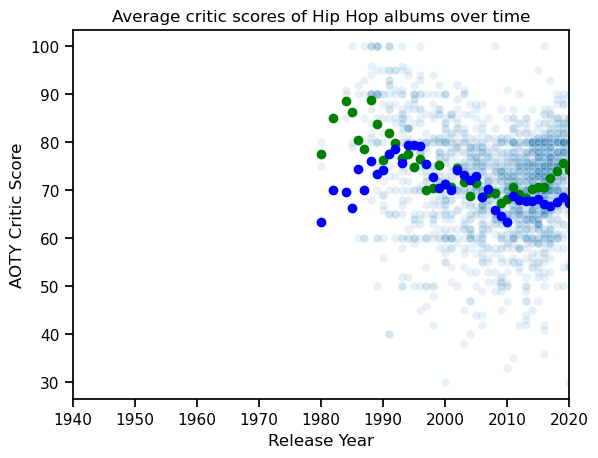

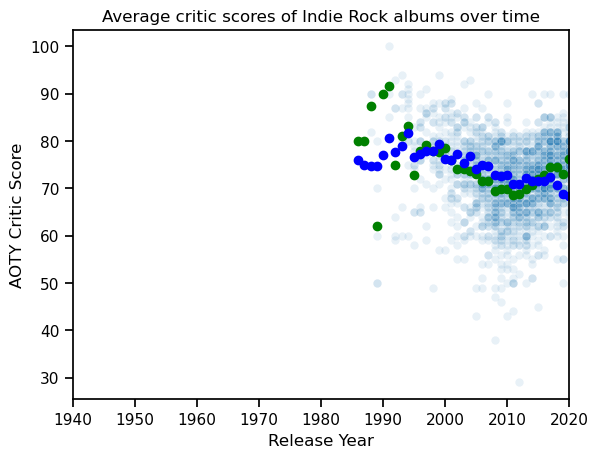

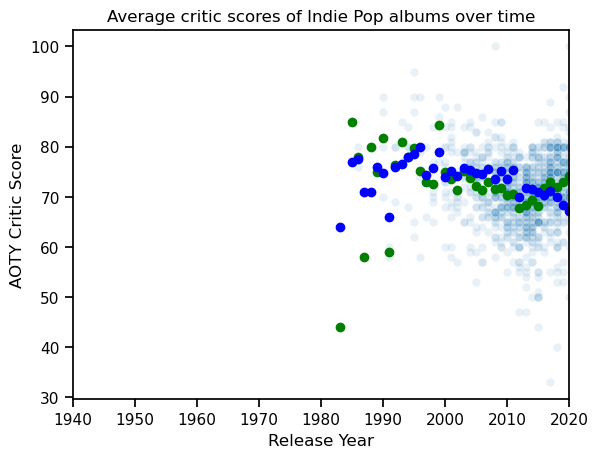

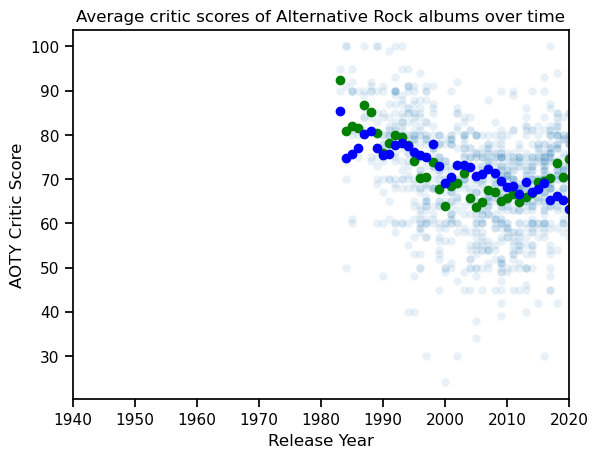

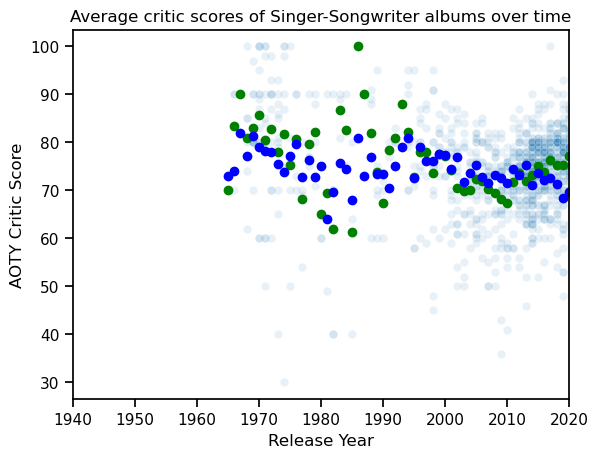

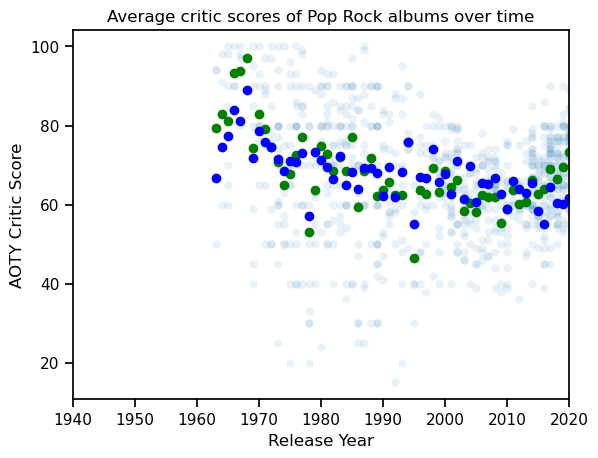

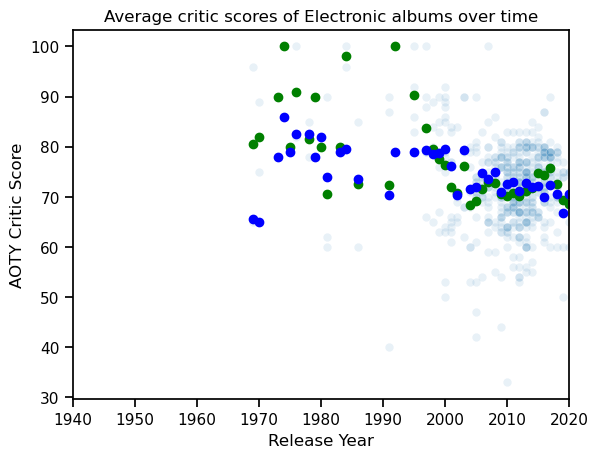

In [29]:
for genre in v_frequent_genre_cols :
    current_df = total_set[total_set['Genre']==genre]
    sns.scatterplot(data=current_df, x='Release Year', y=critics, alpha=0.1)
    plt.title(f'Average critic scores of {genre} albums over time')
    plt.xlim(1940, 2020)

    starting_year = current_df['Release Year'].min()

    for year in range(starting_year, 2021) :
        yearly_mean = current_df[current_df['Release Year']==year][critics].mean()
        plt.scatter(year, yearly_mean, color='Green')

    for year in range(starting_year, 2021) :
        yearly_mean = current_df[current_df['Release Year']==year][users].mean()
        plt.scatter(year, yearly_mean, color='Blue')

    plt.show()

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\2643450247.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  genre_aggregate = v_frequent_genre_df.groupby(['Release Year', 'Genre']).mean()


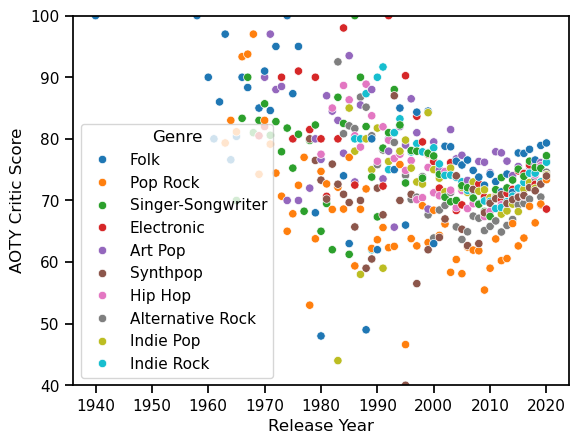

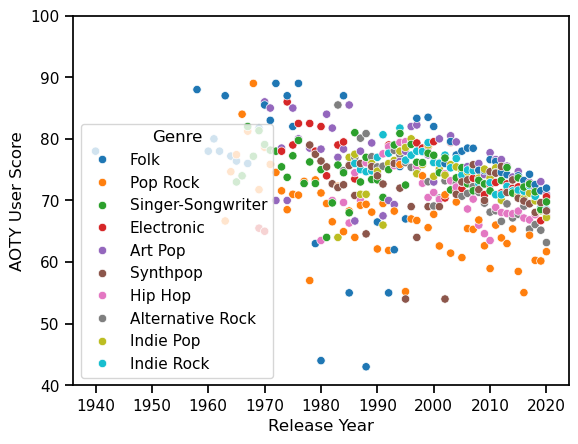

In [60]:
v_frequent_genres = genre_counts[genre_counts > 400]
v_frequent_genre_cols = list(v_frequent_genres.index)
v_frequent_genre_df = total_set[total_set['Genre'].isin(v_frequent_genre_cols)]

genre_aggregate = v_frequent_genre_df.groupby(['Release Year', 'Genre']).mean()

sns.scatterplot(data=genre_aggregate, x='Release Year',  y=critics, hue='Genre')
plt.ylim(40, 100)
plt.show()

sns.scatterplot(data=genre_aggregate, x='Release Year',  y=users, hue='Genre')
plt.ylim(40, 100)
plt.show()

In [61]:
total_set['Count'] = 1

In [121]:
top_five_at_some_point = set()
yearly_top_5s = {}
genres = total_set[~total_set['Genre'].isnull()]['Genre'].values

yearly_top_5s_df = pd.DataFrame()

for current_year in range(1940, 2021) :
    this_year = total_set[total_set['Release Year']==current_year]
    this_year_grouped = this_year.groupby('Genre').agg({'Count':'sum', critics:'mean'})
    this_year_sorted = this_year_grouped.sort_values(by='Count', ascending=False)
    this_years_top = this_year_sorted.iloc[0:5]
    this_years_top['Release Year'] = current_year

    yearly_top_5s_df = pd.concat([yearly_top_5s_df, this_years_top])


    years_top_genres = set(this_years_top.index)
    top_five_at_some_point = top_five_at_some_point.union(years_top_genres)

yearly_top_5s_df.head()

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3571316225.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_years_top['Release Year'] = current_year
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3571316225.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_years_top['Release Year'] = current_year
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\3571316225.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

,Count,AOTY Critic Score,Release Year
Genre,,,
Folk,1,100.0,1940
Traditional Pop,1,80.0,1946
Exotica,1,90.0,1950
Jazz,2,75.0,1951
Jazz,5,88.0,1952


C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\4140982716.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if type(genre_tracker) == type(pd.Series()) :
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\4140982716.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if type(genre_tracker) == type(pd.Series()) :
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\4140982716.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if type(genre_tracker) == type(pd.Series()) :
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\4140982716.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. 

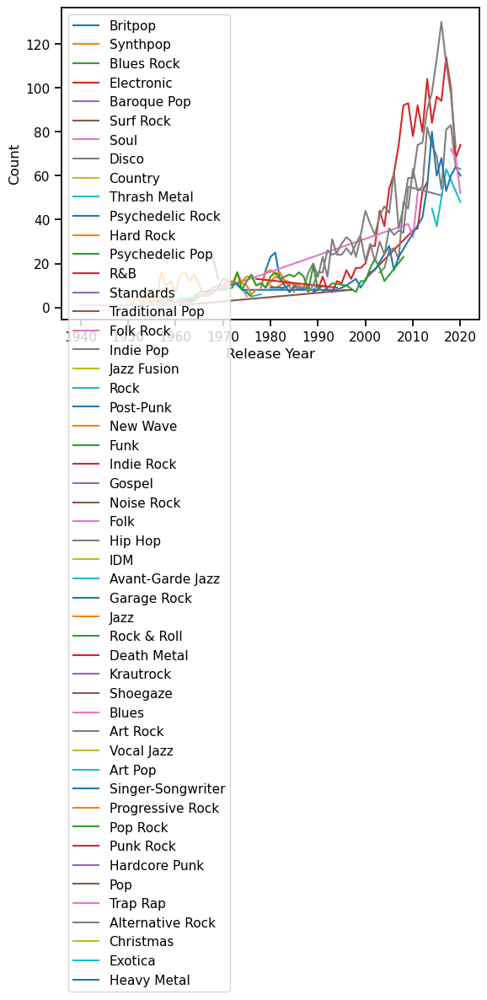

In [123]:
for genre in top_five_at_some_point :
    genre_tracker = yearly_top_5s_df.loc[genre]
    if type(genre_tracker) == type(pd.Series()) :
        genre_tracker = pd.DataFrame(genre_tracker).T
    sns.lineplot(data=genre_tracker, x='Release Year', y='Count', label=genre)

In [144]:
decade_top_five_at_some_point = set()
decade_top_5s = {}
genres = total_set[~total_set['Genre'].isnull()]['Genre'].values
decades = total_set['Release Decade'].unique()

decade_top_5s_df = pd.DataFrame()


for decade in decades :
    this_decade = total_set[total_set['Release Decade']==decade]
    this_decade_grouped = this_decade.groupby('Genre').agg({'Count':'sum', critics:'mean'})
    this_decade_sorted = this_decade_grouped.sort_values(by='Count', ascending=False)
    this_decades_top = this_decade_sorted.iloc[0:5]
    this_decades_top['Release Decade'] = decade

    decade_top_5s_df = pd.concat([decade_top_5s_df, this_decades_top])


    decades_top_genres = set(this_decades_top.index)
    decade_top_five_at_some_point = decade_top_five_at_some_point.union(decades_top_genres)

decade_top_5s_df.head()

C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\320005072.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_decades_top['Release Decade'] = decade
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\320005072.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  this_decades_top['Release Decade'] = decade
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\320005072.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = 

,Count,AOTY Critic Score,Release Decade
Genre,,,
Indie Rock,531,72.071563,2000
Hip Hop,449,70.093541,2000
Alternative Rock,318,66.522013,2000
Indie Pop,237,72.443038,2000
Singer-Songwriter,182,71.038462,2000


C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\2356627342.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  grouped_decades = relevant_rows.groupby(["Genre", "Release Decade"]).sum().reset_index()
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\2356627342.py:6: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if type(genre_tracker) == type(pd.Series()) :
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\2356627342.py:6: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if type(genre_tracker) == type(pd.Series()) :
C:\Users\Josh\AppData\Local\Temp\ipykernel_36912\23566273

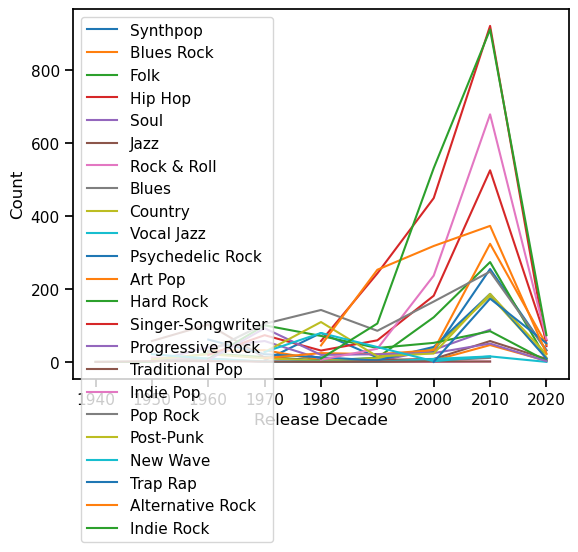

In [138]:
relevant_rows = total_set[total_set['Genre'].isin(decade_top_five_at_some_point)]
grouped_decades = relevant_rows.groupby(["Genre", "Release Decade"]).sum().reset_index()

for genre in decade_top_five_at_some_point :
    genre_tracker = grouped_decades[grouped_decades['Genre']==genre]
    if type(genre_tracker) == type(pd.Series()) :
        genre_tracker = pd.DataFrame(genre_tracker).T
    sns.lineplot(data=genre_tracker, x='Release Decade', y='Count', label=genre)

In [145]:
for genre in decade_top_five_at_some_point :
    
    genre_tracker = decade_top_5s_df[genre]

    if type(genre_tracker) == type(pd.Series()) :
        genre_tracker = pd.DataFrame(genre_tracker).T

    sns.lineplot(data=genre_tracker, x='Release Decade', y='Count', label=genre)

KeyError: 'Synthpop'

In [150]:
yearly_counts = total_set.groupby('Release Year').agg({'Count':'sum', critics:'mean'}).reset_index()

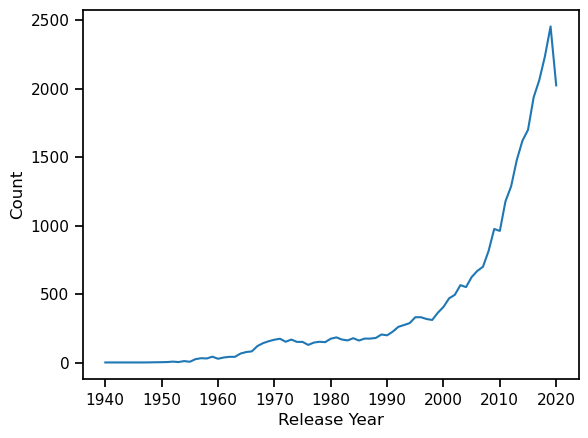

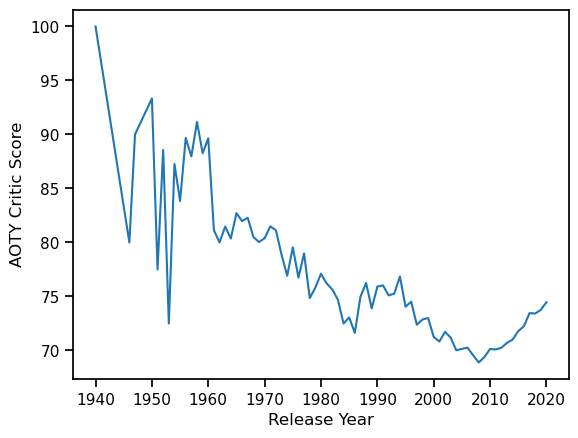

In [152]:

sns.lineplot(data=yearly_counts, x='Release Year', y='Count')
plt.show()
sns.lineplot(data=yearly_counts, x='Release Year', y=critics)
plt.show()

SCRATCH
---

In [ ]:
fig, ax = plt.subplots()

count_df = post_70_set.groupby('Release Year').count()

sns.lineplot(data=count_df, x='Release Year', y='Genre', label='Number of genres represented', ax=ax)

plt.axvline(x=2004, color='Gray', linestyle='--')
plt.annotate('2004', color='Gray', xy=(2005, 200))

plt.axvline(x=2014, color='Red', linestyle='--')
plt.annotate('2014', color='Red', xy=(2015, 200))


# -------

ax2 = ax.twinx()

count_df['Ratio'] = 1

for year in range(1971, 2020) :
    no_of_albums = count_df.loc[year, 'Title']
    no_of_genres = len(post_70_set[post_70_set['Release Year']==year]['Genre'].unique())
    ratio = no_of_albums / no_of_genres
    count_df.loc[year, 'Ratio'] = ratio

sns.lineplot(data=count_df, x='Release Year', y='Ratio', color='Green', label='Ratio of albums to genre', ax=ax2)

plt.ylabel('Number of albums per genre')

# plt.title('Number of albums per genre in each year')

fig.legend()

plt.tight_layout()

plt.show()